In [1]:
from scipy.io import loadmat
from scipy.interpolate import griddata
import numpy as np
from numpy import matlib
from pathlib import Path
import matplotlib.pyplot as plt
from matplotlib import animation
plt.rcParams['animation.html'] = 'jshtml'

import model
import importlib
importlib.reload(model)
from model import *

In [2]:
earth_model=loadmat('data/MMC10.MAT')

In [3]:
ep = earth_model['ep']
mu = earth_model['mu']
sig = earth_model['sig']
x = earth_model['x'].flatten()
z = earth_model['z'].flatten()

In [4]:
x.shape, z.shape, ep.shape, mu.shape, sig.shape

((201,), (111,), (201, 111), (201, 111), (201, 111))

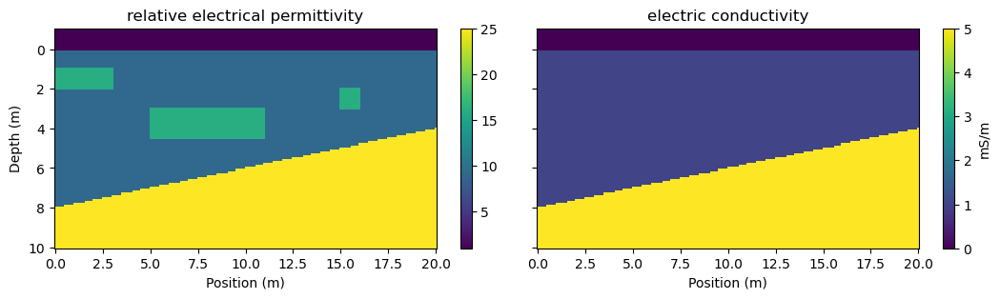

In [5]:
fig, axs = plt.subplots(1, 2, figsize=(13,3), sharey=True, gridspec_kw=dict(wspace=0.01))
ax = axs[0]
im = ax.pcolormesh(x, z, ep.T)
ax.invert_yaxis()
#plt.gca().set_aspect('equal', adjustable='box')
ax.set_title("relative electrical permittivity")
ax.set_xlabel('Position (m)')
ax.set_ylabel('Depth (m)')
plt.colorbar(im, ax=ax)

ax = axs[1]
im = ax.pcolormesh(x, z, sig.T*1000)
ax.set_title("electric conductivity")
ax.set_xlabel('Position (m)')
plt.colorbar(im, ax=ax, label='mS/m')

plt.show()

In [6]:
epmin = np.min(ep)
epmax = np.max(ep)
mumin = np.min(mu)
mumax = np.max(mu)

In [7]:
t = np.arange(0, 100e-9, 1e-10)
srcpulse = blackharrispulse(100e6, t)

# Use finddx.m to determine maximum possible spatial field discretization
dx, wlmin, fmax = finddx(epmax, mumax, srcpulse, t, 0.02)
print(f"Maximum frequency contained in source pulse = {fmax / 1e6} MHz")
print(f"Minimum wavelength in simulation grid = {wlmin} m")
print(f"Maximum possible electric/magnetic field discretization (dx,dz) = {dx} m")
print(f"Maximum possible electrical property discretization (dx/2,dz/2) = {dx / 2} m")

Maximum frequency contained in source pulse = 283.203125 MHz
Minimum wavelength in simulation grid = 0.21171550137706255 m
Maximum possible electric/magnetic field discretization (dx,dz) = 0.04234310027541251 m
Maximum possible electrical property discretization (dx/2,dz/2) = 0.021171550137706253 m


In [8]:
# Set dx and dz here (m) using the above results as a guide
dx = 0.04
dz = 0.04
print(f"Using dx = {dx} m, dz = {dz} m")

Using dx = 0.04 m, dz = 0.04 m


In [9]:
# Find the maximum possible time step using this dx and dz
dtmax = finddt(epmin, mumin, dx, dz)
print(f"Maximum possible time step with this discretization = {dtmax / 1e-9} ns")

Maximum possible time step with this discretization = 0.08086814868731179 ns


In [10]:
# Set proper dt here (s) using the above results as a guide
dt = 8e-11
print(f"Using dt = {dt / 1e-9:.02f} ns")

Using dt = 0.08 ns


In [11]:
# Create time vector (s) and corresponding source pulse
center_freq = 100e6
t = np.arange(0,250e-9, dt)
srcpulse = blackharrispulse(center_freq, t)

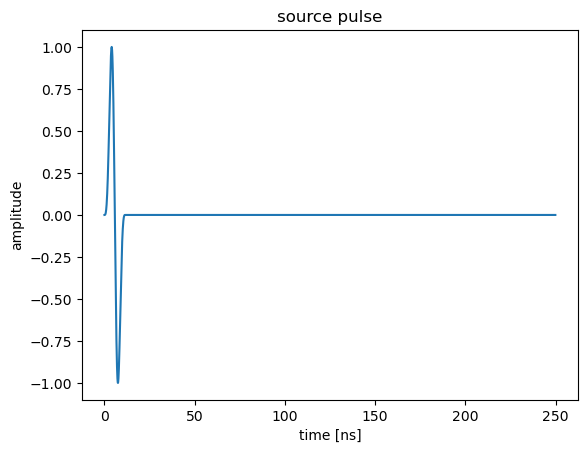

In [12]:
plt.subplots()
plt.plot(t*1e9,srcpulse)
plt.ylabel('amplitude')
plt.xlabel('time [ns]')
plt.title('source pulse')
plt.savefig('figures/srcpulse.png', dpi=300, bbox_inches='tight')
plt.show()

In [14]:
ep.shape, x.shape, z.shape

((201, 111), (201,), (111,))

In [15]:
# Interpolate electrical property grids to proper spatial discretization
x2 = np.arange(min(x), max(x)-dx/2, dx / 2)
z2 = np.arange(min(z), max(z)-dx/2, dz / 2)
# x2 = np.arange(min(x), max(x), dx / 2)
# z2 = np.arange(min(z), max(z), dz / 2)
ep2 = gridinterp(ep, x, z, x2, z2, 'nearest')
mu2 = gridinterp(mu, x, z, x2, z2, 'nearest')
sig2 = gridinterp(sig, x, z, x2, z2, 'nearest')

In [17]:
np.count_nonzero(np.isnan(ep2))

0

In [18]:
x2.shape, z2.shape, ep2.shape

((999,), (549,), (999, 549))

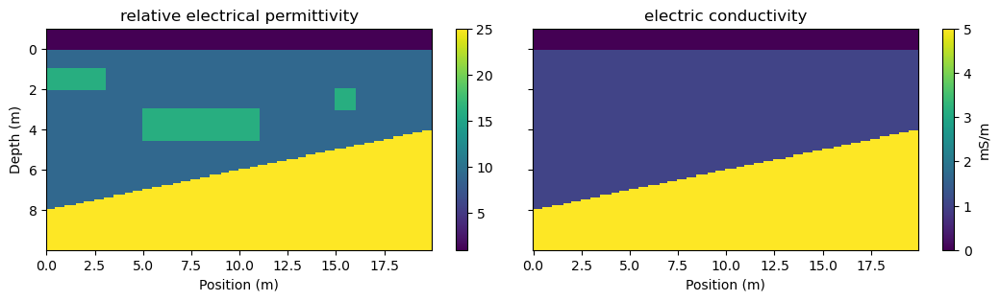

In [199]:
fig, axs = plt.subplots(1, 2, figsize=(13,3), sharey=True, gridspec_kw=dict(wspace=0.01))
ax = axs[0]
im = ax.pcolormesh(x2, z2, ep2.T)
ax.invert_yaxis()
ax.set_title("relative electrical permittivity")
ax.set_xlabel('Position (m)')
ax.set_ylabel('Depth (m)')
plt.colorbar(im, ax=ax)

ax = axs[1]
im = ax.pcolormesh(x2, z2, sig2.T*1000)
ax.set_title("electric conductivity")
ax.set_xlabel('Position (m)')
plt.colorbar(im, ax=ax, label='mS/m')
plt.savefig('figures/earth_model.png', dpi=300, bbox_inches='tight')
plt.show()

In [20]:
# Pad electrical property matrices for PML absorbing boundaries
npml = 10
ep3, x3, z3 = padgrid(ep2, x2, z2, 2*npml+1)
mu3, _, _ = padgrid(mu2, x2, z2, 2*npml+1)
sig3, _, _ = padgrid(sig2, x2, z2, 2*npml+1)

In [154]:
x3.size, x2.size

(1041, 999)

# Single source at x = 10 m

In [180]:
# Create source and receiver location matrices
srcx = np.array([10])
srcz = np.array([0])
recx = np.arange(0, 20, 0.2)
recz = np.zeros_like(recx)

srcloc = np.column_stack((srcx, srcz))
recloc = np.column_stack((recx, recz))

In [181]:
srcloc.shape, recloc.shape

((1, 2), (100, 2))

In [182]:
srcz

array([0])

In [183]:
ep3.shape, mu3.shape, sig3.shape

((1041, 591), (1041, 591), (1041, 591))

In [184]:
# Set some output and plotting parameters
outstep = 4
plotopt = [1, 5, 0.002]

In [185]:
%%time

# Run the simulation
gather, tout, srcx, srcz, recx, recz, wav_cache = TM_model2d_custom(ep3, mu3, sig3, x3, z3, srcloc, recloc, srcpulse, t, npml, outstep, plotopt)

source #: 1
source position: x = 10.0, z = 0.0


  0%|          | 0/3125 [00:00<?, ?it/s]

CPU times: total: 2min 1s
Wall time: 2min


In [186]:
gather.shape, wav_cache.shape

((781, 100, 1), (1, 625, 295, 520))

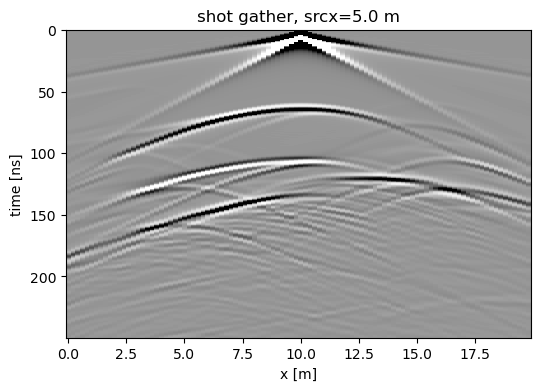

In [198]:
plt.figure(figsize=(6,4))
plt.pcolormesh(recx, tout/1e-9, gather[:,:,0], vmin=-.001, vmax=0.001, cmap='Grays')
plt.gca().invert_yaxis()
plt.ylabel('time [ns]')
plt.xlabel('x [m]')
plt.title(f'shot gather, srcx={srcx[0]:.1f} m')
#plt.colorbar(pad=0.03, aspect=40)
plt.savefig('figures/one_shot.png', dpi=300, bbox_inches='tight')
plt.show()

In [188]:
wav_cache = wav_cache.squeeze()
wav_cache.shape

(625, 295, 520)

In [193]:
idxs = []
ts = []
for it in range(len(t)):
    if (it - 1) % plotopt[1] == 0:
        idxs.append(it)
        ts.append(t[it])

fig, ax = plt.subplots(1, 1, figsize=(6,4))

im = ax.imshow(wav_cache[0,...], extent=[x3[0], x3[-1], z3[-1], z3[0]], vmin=-.002, vmax=0.002, cmap='Grays')
ax.hlines(0, x3[0], x3[-1], color='r', alpha=0.3)
#ax.invert_yaxis()
ax.set_ylabel('depth [m]')
ax.set_xlabel('x [m]')
ax.set_title(f'time {ts[0]*1e9:.2f} ns')

def animate(i):
    im.set_array(wav_cache[i,...])
    ax.set_title(f'time: {ts[i]*1e9:.2f} ns')

frames = np.arange(0, wav_cache.shape[0], 4)
    
ani = animation.FuncAnimation(fig, animate, frames=frames, interval=10)
ani.save(Path('figures/one_shot_wav.mp4'), dpi=300)
plt.close()
ani

# Multiple sources

In [196]:
srcx = np.array([5, 10, 15])
srcz = np.zeros_like(srcx)
recx = np.arange(0, 20, 0.2)
recz = np.zeros_like(recx)

srcloc = np.column_stack((srcx, srcz))
recloc = np.column_stack((recx, recz))

In [112]:
%%time

outstep = 4
plotopt = [1, 20, 0.002]

# Run the simulation
gather, tout, srcx, srcz, recx, recz, wav_cache = TM_model2d_custom(ep3, mu3, sig3, x3, z3, srcloc, recloc, srcpulse, t, npml, outstep, plotopt)

source #: 1
source position: x = 5.0, z = 0.0


  0%|          | 0/3125 [00:00<?, ?it/s]

source #: 2
source position: x = 10.0, z = 0.0


  0%|          | 0/3125 [00:00<?, ?it/s]

source #: 3
source position: x = 15.0, z = 0.0


  0%|          | 0/3125 [00:00<?, ?it/s]

CPU times: total: 5min 35s
Wall time: 5min 31s


### In parallel

In [129]:
%%time

if __name__ == '__main__':
    nsrc = srcloc.shape[0]

    nproc = min(nsrc, 10)
    
    param_list = []
    for i in range(nsrc):
        src_i = np.array([srcloc[i,:]])
        param_list.append([ep3, mu3, sig3, x3, z3, src_i, recloc, srcpulse, t, npml, outstep, plotopt, False])
    with mp.Pool(nproc) as pool:
        result = pool.starmap(TM_model2d_custom, param_list)

len(result)

CPU times: total: 641 ms
Wall time: 2min 26s


3

In [132]:
shot0 = result[0]
shot1 = result[1]
shot2 = result[2]

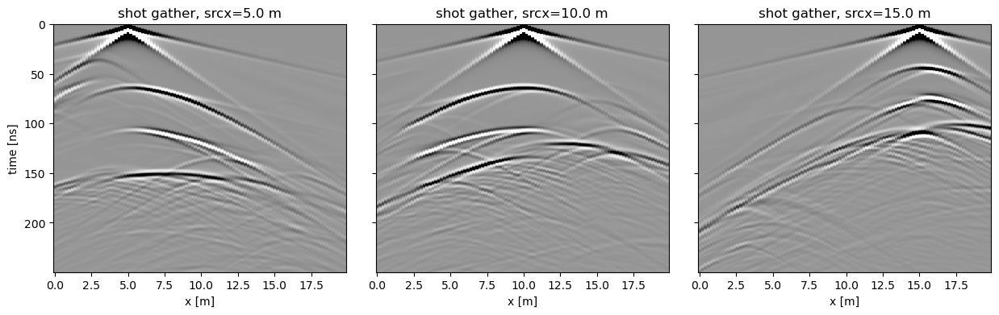

In [197]:
fig, axs = plt.subplots(1, 3, figsize=(15,4), sharey=True, gridspec_kw=dict(wspace=0.1))

for i, (ax, shot) in enumerate(zip(axs, [shot0, shot1, shot2])):
    ax.pcolormesh(recx, tout/1e-9, shot[0].squeeze(), vmin=-.001, vmax=0.001, cmap='Grays')
    ax.invert_yaxis()
    ax.set_xlabel('x [m]')
    ax.set_title(f'shot gather, srcx={srcx[i]:.1f} m')

axs[0].set_ylabel('time [ns]')
plt.savefig('figures/three_shots.png', dpi=300, bbox_inches='tight')
plt.show()

# Lots of sources

In [138]:
srcx = np.arange(0, 20, 0.2)
srcz = np.zeros_like(srcx)
recx = np.arange(0, 20, 0.2)
recz = np.zeros_like(recx)

srcloc = np.column_stack((srcx, srcz))
recloc = np.column_stack((recx, recz))

In [139]:
%%time

if __name__ == '__main__':
    nsrc = srcloc.shape[0]

    nproc = min(nsrc, 10)
    
    param_list = []
    for i in range(nsrc):
        src_i = np.array([srcloc[i,:]])
        param_list.append([ep3, mu3, sig3, x3, z3, src_i, recloc, srcpulse, t, npml, outstep, plotopt, False])
    with mp.Pool(nproc) as pool:
        result = pool.starmap(TM_model2d_custom, param_list)

len(result)

CPU times: total: 1min 1s
Wall time: 1h 13min 53s


100

In [153]:
# Extract common offset reflection GPR data from multi-offset data cube and plot the results
all_shots = np.zeros((result[0][0].shape[0], len(recx), len(srcx)))
co_data = np.zeros((len(tout), len(srcx)))
for i, shot in enumerate(result):
    all_shots[..., i] = shot[0].squeeze()
    co_data[:, i] = shot[0][:, i, 0]

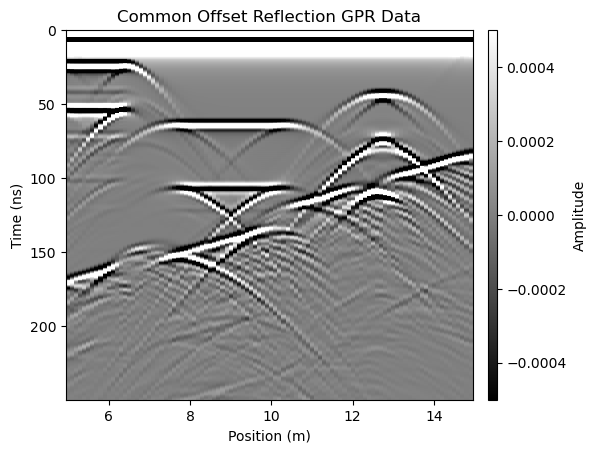

In [194]:
pos = (srcx+recx)/2

plt.figure()
plt.pcolormesh(pos, tout*1e9, co_data, cmap='gray', vmin=-5e-4, vmax=5e-4)
plt.gca().invert_yaxis()
plt.xlabel('Position (m)')
plt.ylabel('Time (ns)')
plt.title('Common Offset Reflection GPR Data')
plt.colorbar(label='Amplitude', pad=0.03, aspect=40)
plt.savefig('figures/common_offset.png', dpi=300, bbox_inches='tight')
plt.show()

In [164]:
import xarray as xr

ds = xr.Dataset(
    data_vars = {'shots' : (('tout', 'recx', 'srcx'), all_shots)},
    coords = {'tout' : tout, 'recx' : recx, 'srcx' : srcx},
    attrs = {'dx' : dx, 'dz' : dz, 'dt' : dt, 'center_frequency' : center_freq}
)
ds

<xarray.Dataset> Size: 62MB
Dimensions:  (tout: 781, recx: 100, srcx: 100)
Coordinates:
  * tout     (tout) float64 6kB 0.0 3.2e-10 6.4e-10 ... 2.493e-07 2.496e-07
  * recx     (recx) float64 800B 0.0 0.2 0.4 0.6 0.8 ... 19.2 19.4 19.6 19.8
  * srcx     (srcx) float64 800B 0.0 0.2 0.4 0.6 0.8 ... 19.2 19.4 19.6 19.8
Data variables:
    shots    (tout, recx, srcx) float64 62MB 5.273e-06 0.0 ... -1.288e-07
Attributes:
    dx:                0.040000000000000036
    dz:                0.040000000000000036
    dt:                8e-11
    center_frequency:  100000000.0

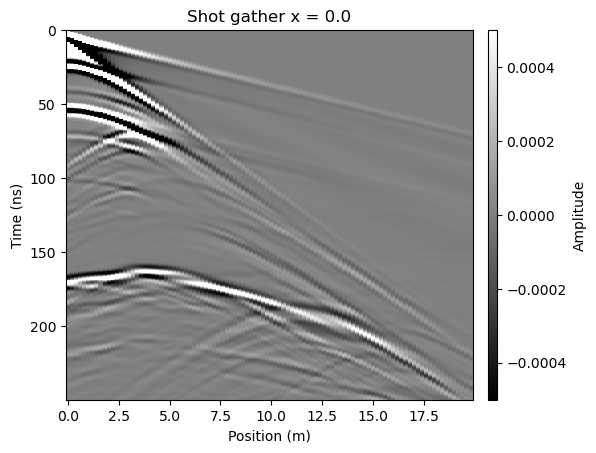

In [175]:
# plotting with xarray data cube

plt.pcolormesh(ds.recx, ds.tout*1e9, ds.shots[...,0], cmap='gray', vmin=-5e-4, vmax=5e-4)
plt.gca().invert_yaxis()
plt.xlabel('Position (m)')
plt.ylabel('Time (ns)')
plt.title(f'Shot gather x = {ds.srcx[0].values}')
plt.colorbar(label='Amplitude', pad=0.03, aspect=40)
plt.show()

In [179]:
plt.rcParams['animation.ffmpeg_path'] = r'C:\\ffmpeg\\bin\\ffmpeg.exe'

fig, ax = plt.subplots(1, 1, figsize=(6,5))

im = ax.pcolormesh(ds.recx, ds.tout*1e9, ds.shots[...,0], cmap='gray', vmin=-5e-4, vmax=5e-4)
ax.invert_yaxis()
ax.set_xlabel('Position (m)')
ax.set_ylabel('Time (ns)')
ax.set_title(f'Shot gather x = {ds.srcx[0].values:.1f}')

def animate(i):
    im.set_array(ds.shots[..., i])
    ax.set_title(f'Shot gather x = {ds.srcx[i].values:.1f}')

frames = np.arange(len(srcx))
    
ani = animation.FuncAnimation(fig, animate, frames=frames, interval=10)
ani.save(Path('figures/shots.mp4'), dpi=300)
plt.close()
ani

In [173]:
ds.to_netcdf(Path('output/paper_simulation.nc'))

# Reproduce Figure 1

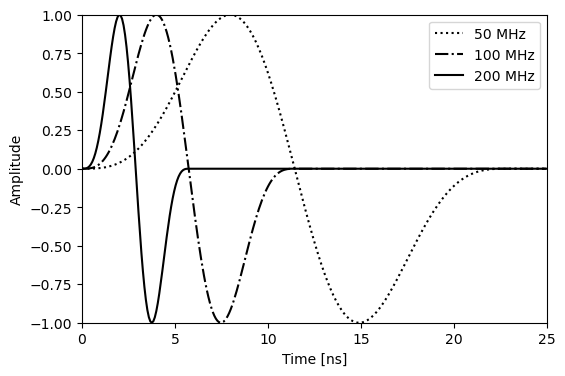

In [174]:
t2 = np.arange(0, 25e-9, dt)

frequencies = [50e6, 100e6, 200e6]
styles = ['dotted', 'dashdot', 'solid']

plt.figure(figsize=(6,4))

for f, style in zip(frequencies, styles):
    pulse = blackharrispulse(f, t2)
    plt.plot(t2*1e9, pulse, label=f'{f/1e6:.0f} MHz', linestyle=style, color='k')
plt.xlabel('Time [ns]')
plt.ylabel('Amplitude')
plt.xlim(0, 25)
plt.ylim(-1, 1)
plt.legend()
plt.show()